## SpaGFT Tutorial：Visium Human Lymph Node

### Outline
1. Import packages
<br />
<br />
2. Load data
<br />
<br />
3. QC and preprocessing
<br />
<br />
4. Function: identify spatially variable genes
<br />
<br />
5. Function: gene expression enhancement
<br />
<br />
6. Function: characterize tissue modules

The installation steps can be found [here](https://github.com/jxLiu-bio/SpaGFT). SpaGFT is a python package to analyze spatial transcriptomics data via graph Fourier transform. To install SpaGFT, the python version is required to be >= 3.7. You can check your python version by:

In [1]:
import platform
platform.python_version()

'3.8.0'

### 1. Import packages

In [2]:
import SpaGFT as spg
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import os


sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

scanpy==1.9.1 anndata==0.9.1 umap==0.5.3 numpy==1.21.5 scipy==1.8.0 pandas==1.4.2 scikit-learn==1.0.2 statsmodels==0.14.0 python-igraph==0.9.10 louvain==0.7.1 pynndescent==0.5.10


To begin with, define the folder to save the results which are generated from the following analysis:|

In [3]:
results_folder = './results/lymph_nodes_analysis/'
if not os.path.exists(results_folder):
    os.makedirs(results_folder)

### 2. Load data

This tutorial uses a publicly available Visium dataset of the human lymph node. The dataset can be downloaded easily through ```Scanpy```. Two key elements are essential for running SpaGFT: the raw gene counts matrix and spatial coordinates of spots. In addition, these two elements should be integrated into an ```anndata``` object, which is a frequently-used python object.

In [4]:
# Load data
adata = sc.datasets.visium_sge(sample_id="V1_Human_Lymph_Node")
adata.var_names_make_unique()
# Add raw to anndata object
adata.raw = adata

100%|██████████| 7.86M/7.86M [00:00<00:00, 25.7MB/s]


You can also create your datasets which are ```anndata``` objects. Note that the raw count matrix should be found in adata.X, and the spatial coordinates of all spots should be found in ```adata.obs``` or ```adata.obsm```. You can use diverse functions provided by scanpy to create the anndata object. For example, you can read Visium datasets by
```Python
sc.read_visium() # recommend
```
Alternatively, users can also create the anndata object using the raw count matrix and spatial coordinates of spots in a direct way:
```Python
count_mtx = pd.read_csv(PATH_TO_COUNT_MATRIX)
coord_mtx = pd.read_csv(PATH_TO_COORDINATE_MATRIX)
count_mtx.iloc[:5, :5]
coord_mtx.iloc[:5, :5]
# create the anndata object
adata = sc.AnnData(count_mtx)
adata.obs.loc[:, ['x', 'y']] = coord_mtx
adata.var_names_make_unique()
adata.raw = adata
```
More approaches to load datasets can be found at [Scanpy](https://scanpy.readthedocs.io/en/stable/api.html#reading)

### 3. QC and preprocessing
Before the formal analysis, we perform some basic filtering of genes and normalize Visium counts data with the ```normalize_total``` method from Scanpy followed by log-transform.

In [5]:
# QC
sc.pp.filter_genes(adata, min_cells=10)
# Normalization
sc.pp.normalize_total(adata, inplace=True)
sc.pp.log1p(adata)

### 4. Function: identify spatially variable genes

#### 4.1 Determine the Fourier modes and identify SVGs

To begin with, determine the number of Fourier modes for detecting SVGs. SpaGFT provides the dermine_frequency_ratio function based on the kneedle algorithm to determine how many FMs used automatically.
Note that *ratio_low * $\sqrt{n}$* and *ratio_high * $\sqrt{n}$* are the recommended low-frequency and high-frequency FMs, where *$\sqrt{n}$* is the number of spots in the original dataset.

In [6]:
# determine the number of low-frequency FMs and high-frequency FMs
(ratio_low, ratio_high) = spg.gft.determine_frequency_ratio(adata,
                                                            ratio_neighbors=1)

Obatain the Laplacian matrix


In [7]:
# calculation
gene_df = spg.detect_svg(adata,
                         spatial_info=['array_row', 'array_col'],
                         ratio_low_freq=ratio_low,
                         ratio_high_freq=ratio_high,
                         ratio_neighbors=1,
                         filter_peaks=True,
                         S=6)
# S determines the  sensitivity of kneedle algorithm
# extract spaitally variable genes
svg_list = gene_df[gene_df.cutoff_gft_score][gene_df.qvalue < 0.05].index.tolist()
print("The number of SVGs: ", len(svg_list))
# the top 20 SVGs
print(svg_list[:20])

The precalculated low-frequency FMs are USED
The precalculated high-frequency FMs are USED
Graph Fourier Transform finished!
SVG ranking could be found in adata.var['svg_rank']
The spatially variable genes judged by gft_score could be found 
          in adata.var['cutoff_gft_score']
Gene signals in frequency domain when detect SVGs could be found
          in adata.varm['freq_domain_svg']
The number of SVGs:  1346
['IFI44L', 'ISG15', 'MT-CO2', 'IFI6', 'MX1', 'MT-CO1', 'EEF1A1', 'CXCL12', 'TMSB4X', 'ACTG1', 'IFI44', 'IFIT1', 'CCL2', 'GAPDH', 'MT-CO3', 'RPL32', 'OASL', 'RPS2', 'SFRP2', 'ACTB']


#### 4.2 Visualize the identified SVGs

We will visualize several detected genes which exhibit diverse spatial patterns. This step can be achieved by ```sc.pl.spatial``` function provided by scanpy or our built-in ```scatter_gene``` function to visualize gene expression patterns.

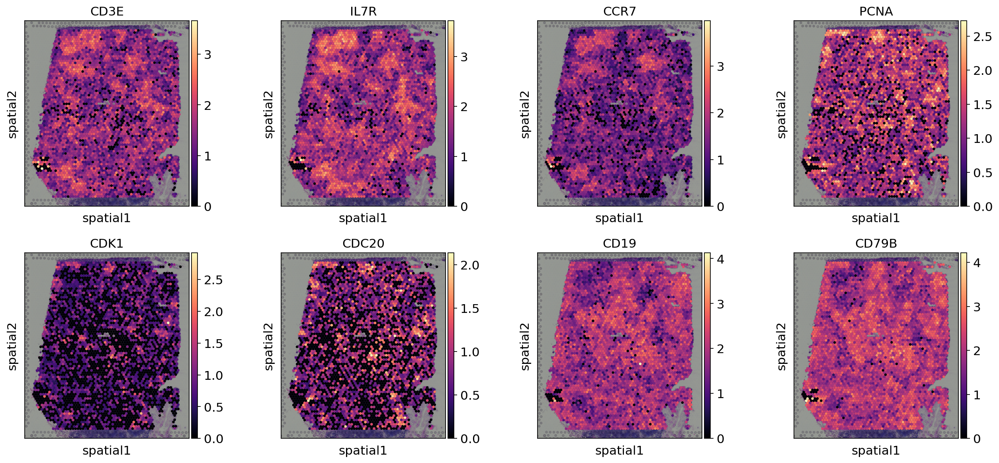

In [8]:
plot_svgs = ['CD3E', 'IL7R', 'CCR7', 'PCNA', 'CDK1', 'CDC20', 'CD19', 'CD79B']
sc.pl.spatial(adata, color=plot_svgs, size=1.6, cmap='magma', use_raw=False)

#### 4.3 Plot frequency signals

One of the characteristics of SpaGFT is that it can obtain new representations for genes in the frequency domain. In the above genes' normalized frequency signals can be found in ```adata.varm['freq_domain_svg']``` and visualized by

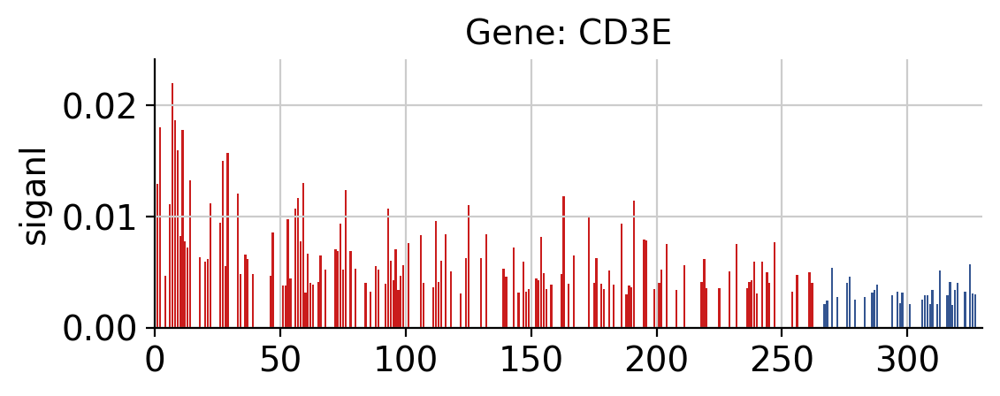

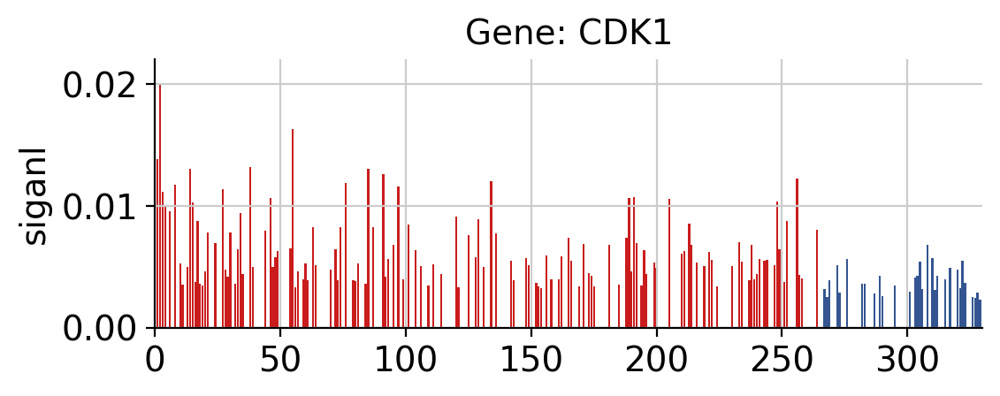

In [9]:
spg.plot.gene_freq_signal(adata, gene=plot_svgs[0])
spg.plot.gene_freq_signal(adata, gene=plot_svgs[4])

where the red signals correspond to low-frequency signals, while the blue signals correspond to high-frequency signals. 

#### 4.4 UMAP visualization of gene frequency signals

In addition, we can also separate SVGs and non-SVGs in the frequency domain. By projecting the frequency domain to 2-dimensional space by UMAP, we can verify this easily:

The umap coordinates of genes when identify SVGs could be found in 
          adata.varm['freq_umap_svg']


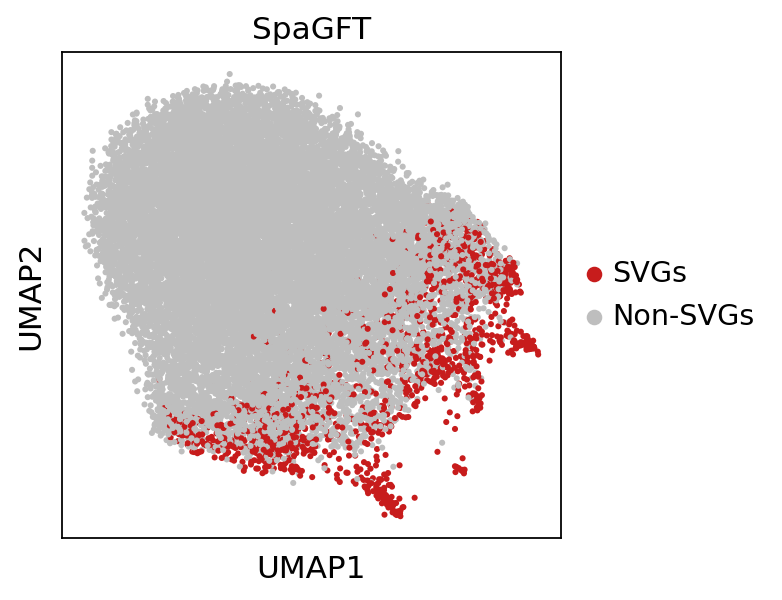

In [10]:
# gene umap
spg.plot.gene_signal_umap(adata, svg_list, size=30)
svg_umap_df = pd.DataFrame(adata.varm['freq_umap_svg'],
                           index=adata.var_names,
                           columns=['UMAP_1', 'UMAP_2'])

### 5 Function: gene expression enhancement

SRT expression data suffers from high noise, which will influence the credibility of analytical results. Therefore, SpaGFT adapts a low-pass filter to process signals in the frequency domain and performs inverse GFT to obtain enhanced signals. Note that this step is time-consuming and will take several minutes for Visium datasets.

In [11]:
# copy from the original dataset
new_adata = adata.copy()
new_adata = spg.low_pass_enhancement(new_adata,
                                     inplace=True,
                                     c=0.001,
                                     ratio_low_freq=15)

where,  parameter c controls the balance of the smoothness and similarity with the original dataset. For the fine-grained tissue, we recommend a low c to preserve more details.

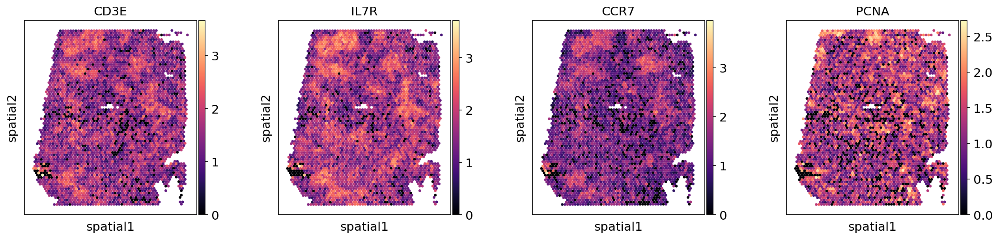

In [12]:
# Before enhancement
sc.pl.spatial(adata, color=plot_svgs[:4], img_key=None, size=1.6, cmap='magma', use_raw=False)

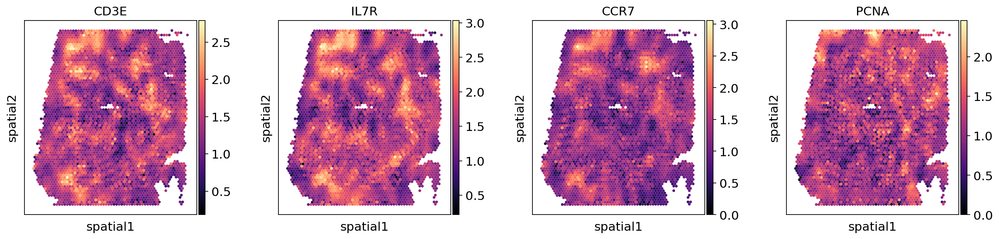

In [13]:
# After enhancement
sc.pl.spatial(new_adata, color=plot_svgs[:4], img_key=None, size=1.6, cmap='magma', use_raw=False)

In the following, we will use the enhanced gene expression matrix for analysis.

### 6. Function: identify tissue modules

#### 6.1 Group SVGs based on frequency signals

The core of SpaGFT is that it can utilize SVGs to characterize tissue modules by groups of SVGs with coincident spatial patterns. To achieve this, SpaGFT will analyze and process the signal's low-frequency parts. In SpaGFT, the Louvain algorithm is used to cluster frequency signals of genes whose parameter resolution will be selected based on the designed objective function. Users can input the range of resolution by giving ```(start, end, step)```.

In [14]:
# identify tissue modules (TM)
gene_df, new_adata = spg.identify_tissue_module(new_adata, 
                                     svg_list=svg_list,
                                     ratio_fms=ratio_low,
                                     resolution=(0.5, 1.5, 0.1),
                                     ratio_neighbors=2,
                                     n_neighbors=15)

resolution: 100%|██████████| 10/10 [00:11<00:00,  1.16s/it, score=0.152]


The above step will identify gene groups based on their spatial patterns. and the results can be found at ```adata.var.['tissue_module']```. The genes in a group support a common spatial pattern, which is called a tissue module. Besides, the tissue module information can be found at ```adata.obsm['tm_binary']```.

In [15]:
# the genes which support corresponding tissue modules
gene_df.to_csv(os.path.join(results_folder,
                           'Lymphnode_gene_information_results.csv'))
gene_df.iloc[:5, :]

,gene_ids,feature_types,genome,n_cells,gft_score,svg_rank,cutoff_gft_score,pvalue,qvalue,tissue_module
IFI44L,ENSG00000137959,Gene Expression,GRCh38,1882,4.973869,1,True,5.813716e-80,6.207737e-78,8
ISG15,ENSG00000187608,Gene Expression,GRCh38,3054,4.877024,2,True,2.888858e-55,1.733219e-53,8
MT-CO2,ENSG00000198712,Gene Expression,GRCh38,4030,4.615628,3,True,2.816433e-100,5.385450e-98,6
IFI6,ENSG00000126709,Gene Expression,GRCh38,2681,4.561138,4,True,9.051660e-80,9.630435e-78,8
MX1,ENSG00000157601,Gene Expression,GRCh38,3326,4.508339,5,True,1.832998e-49,9.583907e-48,8


The last column indicates the supported tissue modules.

#### 6.2 Visualize clustering results

We can visualize the clustering results by UMAP in this way:

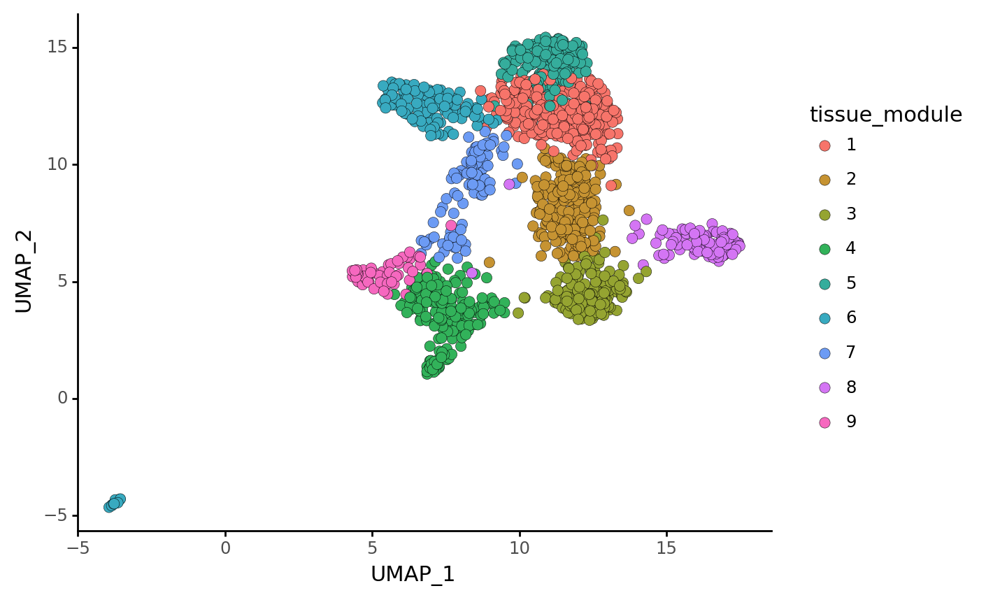

In [16]:
spg.plot.scatter_umap_clustering(new_adata, svg_list)

There are nine modules via our computation. In the following, we will visualize the results.

#### 6.3 Extract tissue module information

In [17]:
# The tissue module information can be obtained by
tm_binary_df = new_adata.obsm['tm_binary']
tm_binary_df.to_csv(os.path.join(results_folder,
                           'Lymphnode_tissue_module_information_results.csv'))
tm_binary_df.iloc[:5, :]

,tm_1,tm_2,tm_3,tm_4,tm_5,tm_6,tm_7,tm_8,tm_9
AAACAAGTATCTCCCA-1,0,1,0,1,0,0,0,0,0
AAACAATCTACTAGCA-1,1,1,1,0,0,1,0,0,0
AAACACCAATAACTGC-1,1,1,0,1,1,1,1,0,0
AAACAGAGCGACTCCT-1,1,1,0,0,1,1,1,1,0
AAACAGCTTTCAGAAG-1,0,1,0,0,0,1,1,0,0


The rows of the above dataframe indicate the spots, and the columns indicate the tissue module. Among them, '1' reflects the structure of a tissue module. 

#### 6.4 Visualize interested TMs

We can visualize the interested tissue modules by built-in scatter_tm function:

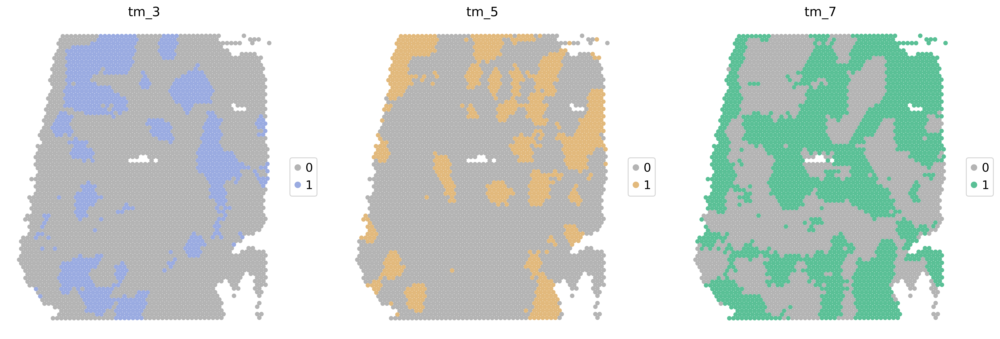

In [18]:
# plot tms
spg.plot.scatter_tm(new_adata, 
                    tm=['tm_3', 'tm_5', 'tm_7'],
                    tm_color=['#9aabe1', '#e2b97c', '#5ac096'],
                    spatial_info='spatial',
                    size=15)

Specifically, we can also visualize the tissue module and genes that support this tissue module. In the following, we will explore a specific tissue module, tm_3

In [19]:
# plot tm's spatial map and corresponding genes
spg.plot.scatter_tm_gene(new_adata,
                         tm="tm_3",
                         tm_color='#9aabe1',
                         gene=['CD3E','IL7R','CCR7'],
                         spatial_info='spatial',
                         size=13)

#### 6.5 Enrichment analysis of biological process

A group of genes that support a tissue module has a similar spatial pattern, and we can perform functional enrichment analysis to explore the underlying biological process under this pattern.

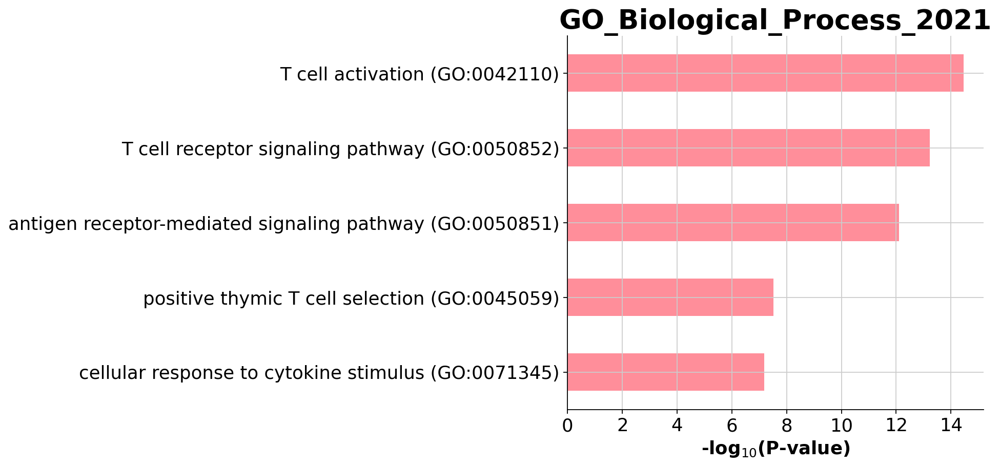

In [20]:
# GO enrichment analysis
import gseapy as gp
tm_gene_list = gene_df[gene_df.tissue_module == '3'].index.tolist()
enr = gp.enrichr(gene_list=tm_gene_list,
                  gene_sets=['BioPlanet_2019','GO_Biological_Process_2021',
                            'ChEA_2016'],
                  organism='Human',
                  description='Tissue_module',
                  outdir='./results/lymph_nodes_analysis/enrichr_kegg',
                  no_plot=False,
                  cutoff=0.5 # test dataset, use lower value from range(0,1)
                )
enr_results = enr.results
from gseapy.plot import barplot, dotplot
barplot(enr.results[enr.results.Gene_set=='GO_Biological_Process_2021'],
        column='P-value', 
        color='#FF6879',
        top_term=5,
        title='GO_Biological_Process_2021')

#### 6.6 Obtain TM ID card

We can also merge the above results to generate a tissue module id card.
Limited by resolutions of SRT techniques, most SRT techniques can not achieve single-cell resolution. Luckily, up to now, many tools have been developed to integrate information from scRNA-seq and SRT to obtain the spatial distributions of each cell type. Here, we use the deconvolution results from [cell2location](https://github.com/BayraktarLab/cell2location).

In [21]:
# load normalized deconvolution resutls from cell2location
decon_results = pd.read_csv("./data/lymphnode_cell2location_results.csv",
                           index_col=0)
# add deconcolutions to anndata object
new_adata.obsm['cell_type_proportion'] = decon_results

Now, we show the details of tissue module 3

In [22]:
spg.plot.draw_tissue_module_id_card(adata=new_adata,
                                    svg_list=svg_list,
                                    tm='3',
                                    deconvolution_key='cell_type_proportion',
                                    tm_overlap_show=['5', '7'],
                                    tm_color=['#9aabe1', '#e2b97c', '#5ac096', '#c17a71', '#c265b6'],
                                    spatial_info='spatial')